In [ ]:
#pip install -U kaleido

In [ ]:
import pandas as pd
import matplotlib as plt
import plotly.express as px
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import random, math
import numpy as np
import statistics
import kaleido

In [ ]:
df = pd.read_csv('data.csv')

In [ ]:
# Separate the rows where the result is "0:0"
df_00 = df[df['Result'] == '0:0']

# Separate the rows where the result is not "0:0" and drop rows with NaN values
df_not_00 = df[df['Result'] != '0:0'].dropna()

# Combine the two DataFrames
df = pd.concat([df_00, df_not_00])

In [ ]:
df['Date'] = pd.to_datetime(df['Date']).dt.year

In [ ]:
def determine_winner(result):
    home_score, away_score = map(int, result.split(':'))
    if home_score > away_score:
        return "Home"
    elif home_score < away_score:
        return "Away"
    else:
        return "Draw"

In [ ]:
df['who won?'] = df['Result'].apply(determine_winner)

In [ ]:
df_without_minutes = df.drop(['Minute of first Goal'], axis=1)

In [ ]:
df_minutes = pd.DataFrame(df["Minute of first Goal"])

In [ ]:
group_by_result = df_without_minutes.groupby('Result').size().reset_index(name='Count').sort_values('Count', ascending=False)

In [ ]:
fig = px.pie(group_by_result, values='Count', names='Result', title='Most Common Bundesliga Match Outcomes (2009/10 - 2023/24)')
fig.update_traces(textposition='inside', textinfo='label+percent', textfont={"size": 15, "color": "black"})
fig.update_layout(
    autosize=False,
    width=800,
    height=800,
    showlegend=False
)
fig.show()

In [ ]:
group_by_date_and_result = df_without_minutes.groupby(['Date', 'Result']).size().reset_index(name='Count').sort_values(['Date', 'Count'], ascending=False)

In [ ]:
pivot_df = group_by_date_and_result.pivot(index='Date', columns='Result', values='Count').fillna(0)

In [ ]:
pivot_df_percent = pivot_df.div(pivot_df.sum(axis=1), axis=0) * 100
pivot_df_percent = pivot_df_percent[pivot_df_percent.sum().sort_values(ascending=False).index]

(2009.0, 2023.0)

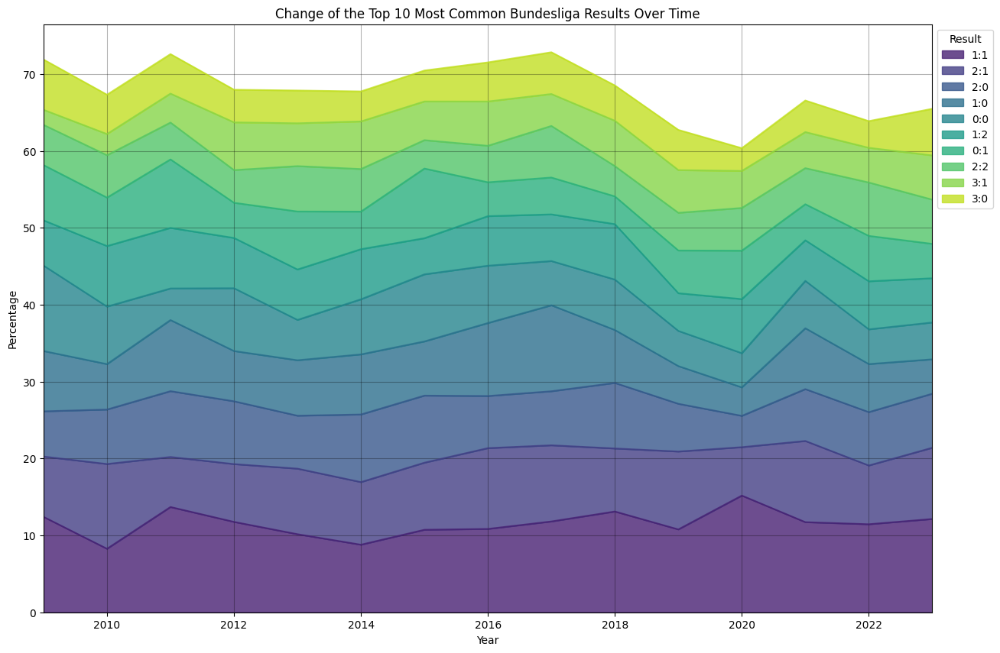

In [ ]:
ax = pivot_df_percent.iloc[:, :10].plot(kind='area', stacked=True, figsize=(15, 10), alpha=0.8, title='Change of the Top 10 Most Common Bundesliga Results Over Time', color=sns.color_palette("viridis", len(pivot_df_percent.iloc[:, :10].columns)))
ax.set_xlabel('Year')
ax.set_ylabel('Percentage')
ax.legend(loc='upper left', bbox_to_anchor=(1, 1), title='Result')
ax.grid(True, alpha=0.3, color="black")
ax.set_xlim(2009, 2023)

In [ ]:
group_by_winner = df_without_minutes.groupby('who won?').size().reset_index(name='Count').sort_values('Count', ascending=False)

In [ ]:
fig = px.pie(group_by_winner, values='Count', names='who won?', title='Bundesliga Match Outcomes by Winning Team (2009/10 - 2023/24)')
fig.update_traces(textposition='inside', textinfo='label+percent', textfont={"size": 20, "color": "white"})
fig.update_layout(
    autosize=False,
    width=800,
    height=800,
    showlegend=False
)
fig.show()

In [ ]:
df_minutes = df_minutes.dropna()
avg_first_goal_minute = round(df_minutes['Minute of first Goal'].mean(), 0)
print(f"On average, the first goal in a match was scored after {int(avg_first_goal_minute)} minutes.")

On average, the first goal in a match was scored after 29 minutes.


In [ ]:
df_minutes['Minute of first Goal'] = df_minutes['Minute of first Goal'].astype(int)

<ipython-input-18-96c46bfb0504>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
fig = px.histogram(df_minutes, x="Minute of first Goal", title='Timing of First Goals in Bundesliga Matches (2009/10 - 2023/24)')
fig.add_vline(x=avg_first_goal_minute, line_dash="dash", line_color="red", annotation=dict(text=f"Average: {int(avg_first_goal_minute)}th minute", showarrow=False, align="left"))
fig.update_layout(
    autosize=False,
    width=800,
    height=800,
    showlegend=False)
fig.show()

In [ ]:
bet = df_minutes[df_minutes['Minute of first Goal'] >= 30].shape[0]
no_bet = df_minutes[df_minutes['Minute of first Goal'] < 30].shape[0]
total_games = df_minutes.shape[0]
print(f"{bet} of the {total_games} matches were valid for the bet, that is {(bet/total_games)*100}% of the matches.")
print(f"{no_bet} of the {total_games} matches were not valid for the bet, that is {(no_bet/total_games)*100}% of the matches.")

1735 of the 4226 matches were valid for the bet, that is 41.05537150970184% of the matches.
2491 of the 4226 matches were not valid for the bet, that is 58.94462849029816% of the matches.


In [ ]:
df_quotes_for_zero_zero = pd.DataFrame(columns=['minute', 'perc_zero_goals', 'perc_over_zero_goals', 'quote_zero_goals', 'quote_over_zero_goals'])

In [ ]:
for minute in range(df_minutes['Minute of first Goal'].max()+1):
    results_by_minute = df[(df['Minute of first Goal'] >= minute) | (df['Minute of first Goal'].isna())].groupby('Result').size().reset_index(name='Count')
    nr_results = results_by_minute['Count'].sum()
    nr_zero_zero = results_by_minute["Count"].loc[results_by_minute['Result'] == "0:0"].values[0]
    perc_zero_zero = round((nr_zero_zero / nr_results) * 100, 2)
    df_quotes_for_zero_zero.loc[minute] = [minute, perc_zero_zero, 100-perc_zero_zero, round(100/perc_zero_zero,2), round(100/(100-perc_zero_zero),2)]

In [ ]:
# Create the first plot with Plotly Express for Probability of 0:0 Draw
fig1 = px.line(df_quotes_for_zero_zero[:45], x='minute', y='perc_zero_goals', markers=True)
fig1.update_traces(marker=dict(symbol="circle", size=5))

# Create the second plot with Plotly Express for Odds for Over 0.5 Goals
fig2 = px.line(df_quotes_for_zero_zero[:45], x='minute', y='quote_over_zero_goals', markers=True, text='quote_over_zero_goals')
fig2.update_traces(marker=dict(symbol="circle", size=5), textposition='top center', textfont=dict(size=10))

# Combine the two plots into one with two y-axes using Plotly Graph Objects
fig = go.Figure()

# Add the first trace (Probability of 0:0 Draw)
fig.add_trace(
    go.Scatter(
        x=df_quotes_for_zero_zero['minute'],
        y=df_quotes_for_zero_zero['perc_zero_goals'],
        mode='lines+markers',
        name="Probability of 0:0 Draw",
        marker=dict(symbol="circle", size=5),
        hoverinfo='y',
        line=dict(color='blue'),
        yaxis='y1'
    )
)

# Add the second trace with a secondary y-axis (Odds for Over 0.5 Goals)
fig.add_trace(
    go.Scatter(
        x=df_quotes_for_zero_zero['minute'],
        y=df_quotes_for_zero_zero['quote_over_zero_goals'],
        mode='lines+markers+text',
        name="Odds for Over 0.5 Goals",
        marker=dict(symbol="square", size=5),
        hoverinfo='y',
        line=dict(color='green'),
        text=df_quotes_for_zero_zero['quote_over_zero_goals'].astype(str),
        textposition='bottom center',
        textfont=dict(size=8),
        yaxis='y2'
    )
)

# Update layout for the combined plot
fig.update_layout(
    title="Probability of 0:0 Draw and Odds for Over 0.5 Goals",
    width=1500,
    xaxis=dict(title="Minute", range=[-0.5, 45.5]),
    yaxis=dict(title="Probability (%)", range=[4.7619047619, 24]),
    yaxis2=dict(
        title="Odds",
        overlaying='y',
        side='right',
        range=[1.05, 1.32],  # Adjust range based on your data
        tickformat='.2f'  # Optional: format ticks as desired
    )
)

fig.show()


In [ ]:
# Define the intervals (every 5 minutes from 0 to 90)
intervals = range(0, 96, 5)

# Initialize a list to store each pie chart figure
figures = []

# Loop through each interval
for start_minute in intervals:
    # Filter dataframe for matches within the current interval
    filtered_df = df[(df['Minute of first Goal'] >= start_minute) | (df['Minute of first Goal'].isna())]

    # Group by 'Result' and count occurrences
    group_by_result = filtered_df.groupby('Result').size().reset_index(name='Count').sort_values('Count', ascending=False)

    # Create a pie chart for the current interval
    fig = px.pie(group_by_result, values='Count', names='Result',
                 labels={'Result': 'Outcome', 'Count': 'Count'})

    # Customize pie chart appearance
    fig.update_traces(textposition='inside', textinfo='label+percent', textfont={"size": 13, "color": "black"})

    # Append the pie chart figure to the list
    figures.append(fig)

# Create a super chart with subplots (5 rows, 4 columns)
# Specify 'domain' type for subplots to accommodate pie charts
super_fig = make_subplots(rows=5, cols=4, subplot_titles=[f"Minute {start}" for start in intervals], specs=[[{'type': 'domain'}]*4]*5)

# Add each pie chart as a subplot in the super chart
for i in range(len(figures)):
    row = i // 4 + 1  # Calculate the row index (1-based)
    col = i % 4 + 1   # Calculate the column index (1-based)
    super_fig.add_trace(figures[i]['data'][0], row=row, col=col)

# Update layout for the super chart
super_fig.update_layout(height=2000, showlegend=False, title="Match Outcomes When the Score Remains 0:0 by This Minute")

# Show the super chart
super_fig.show()

In [ ]:
# Parameter
startkapital = 100
gewinnquote = 1.2
erfolgsquote = 0.86
simulations_lauf = 1000  # Anzahl der Wetten, die simuliert werden
wetten_gewonnen = 0

def simulate_wetten(x_prozent, y, z, startkapital, simulations_lauf):
    global wetten_gewonnen
    kapital = startkapital
    investiertes_geld = startkapital * x_prozent  # Anfangsinvestment
    kapital -= investiertes_geld  # Initiales Kapital abziehen
    for _ in range(simulations_lauf):
          if random.random() < erfolgsquote:
              investiertes_geld *= gewinnquote
              wetten_gewonnen += 1
              if wetten_gewonnen == y:
                  # Auszahlung nach y Siegen
                  auszahlen = investiertes_geld * (z / 100)
                  kapital += auszahlen  # z-Prozent des Investierten wird ins Guthaben übertragen
                  investiertes_geld -= auszahlen  # investiertes Geld wird um den ausgezahlten Betrag reduziert
                  wetten_gewonnen = 0  # Siegen zurücksetzen
                  if investiertes_geld < kapital * x_prozent:
                    investiertes_geld = kapital * x_prozent
                    kapital -= investiertes_geld
                    if investiertes_geld <= 1:
                        return kapital
          else:
              investiertes_geld = kapital * x_prozent  # Neues investiertes Geld aus dem verbleibenden Kapital
              kapital -= investiertes_geld  # Kapital reduzieren um den investierten Betrag
              wetten_gewonnen = 0  # Siegen zurücksetzen
              if kapital <= 1:  # Beenden, wenn nicht mehr genug Kapital für einen neuen Einsatz vorhanden ist
                  return kapital

    return kapital

def find_optimal_parameters(startkapital):
    best_params = None
    best_kapital = 0
    for x_prozent in [i * 0.01 for i in range(1, 101)]:  # Prozentsatz des Kapitals (1% bis 100%)
        for y in range(1, 20):  # Maximale Gewinnserie von 1 bis 20
            for z in range(1, 101):  # Auszahlung zwischen 1% und 100%
                kapital = simulate_wetten(x_prozent, y, z, startkapital, simulations_lauf)
                if kapital > best_kapital:
                    best_kapital = kapital
                    best_params = (x_prozent, y, z)
    return best_params, best_kapital

# Run the simulation 100 times and store results in a DataFrame
results = []

for _ in range(100):
    optimal_params, max_kapital = find_optimal_parameters(startkapital)
    results.append({
        'Einsatz (%)': optimal_params[0] * 100,
        'Gewinnserie': optimal_params[1],
        'Auszahlung (%)': optimal_params[2],
        'Maximales Kapital': max_kapital
    })

df_find_best_params = pd.DataFrame(results)

# Display the DataFrame
print(df_find_best_params)

    Einsatz (%)  Gewinnserie  Auszahlung (%)  Maximales Kapital
0          15.0           10              65       3.194752e+08
1          30.0           16              60       1.435151e+08
2          34.0            2              21       1.793653e+09
3          20.0           10              67       6.713926e+07
4          27.0           13              65       7.333234e+08
..          ...          ...             ...                ...
95         17.0           11              50       3.781958e+08
96         40.0            3              31       7.522430e+08
97         16.0           13              68       5.603947e+09
98         13.0           14              80       1.457165e+09
99         13.0           10              25       7.840200e+10

[100 rows x 4 columns]


In [ ]:
df_find_best_params.describe

In [ ]:
df_find_best_params.describe()

,Einsatz (%),Gewinnserie,Auszahlung (%),Maximales Kapital
count,100.000000,100.000000,100.000000,1.000000e+02
mean,24.650000,7.500000,43.630000,1.499655e+10
std,10.704832,4.717258,22.361427,4.545323e+10
min,4.000000,1.000000,9.000000,6.713926e+07
25%,17.000000,4.000000,26.000000,5.770040e+08
50%,23.000000,6.000000,40.500000,1.450573e+09
75%,30.250000,10.000000,59.250000,6.755975e+09
max,75.000000,19.000000,100.000000,3.257965e+11


In [ ]:
MINUTE_TO_BET = 29
ODDS_ON_MINUTE_TO_BET = 1.2
GROUPED_DF = df[(df['Minute of first Goal'] > MINUTE_TO_BET) | (df['Minute of first Goal'].isna())].groupby('Result').size().reset_index(name='Count').sort_values('Count', ascending=False)
SIMULATION_LOOPS = 1000
ALL_GAMES = GROUPED_DF['Count'].sum()
MARGIN = 0.23 #change this

In [ ]:
PERCENTAGE_ZERO_ZERO = int(round((GROUPED_DF["Count"].loc[GROUPED_DF['Result'] == "0:0"].values[0] / ALL_GAMES) * 100,0))
PERCENTAGE_OVER_ZERO_ZERO = 100 - PERCENTAGE_ZERO_ZERO
CASHOUT_HALF_AFTER_X_WINS = math.floor(100/PERCENTAGE_ZERO_ZERO) -1 #change this
CASHOUT_FACTOR = 0.4 # change this
CASHOUT_HALF_AFTER_X_WINS, PERCENTAGE_ZERO_ZERO


(6, 14)

In [ ]:
# Initialize a dictionary to hold DataFrames for each round
df_models = {}
for round_nr in range(SIMULATION_LOOPS):

    INVEST = 23
    BALANCE = 76
    bets_won_in_row = 0
    df_model = pd.DataFrame(columns=['Game', 'Invest', 'Balance', 'Won?'])

    for i in range(ALL_GAMES):
        # Simulate bet outcome
        bet_won = random.choice([False] * PERCENTAGE_ZERO_ZERO + [True] * PERCENTAGE_OVER_ZERO_ZERO)

        if bet_won:
            # Adjust investment and balance for a win
            INVEST *= ODDS_ON_MINUTE_TO_BET
            bets_won_in_row += 1

            # Check if conditions for cashing out half are met
            if bets_won_in_row == CASHOUT_HALF_AFTER_X_WINS:
                CASHOUT = INVEST * CASHOUT_FACTOR
                INVEST -= CASHOUT
                BALANCE += CASHOUT
                bets_won_in_row = 0
                if INVEST < BALANCE * MARGIN:
                  INVEST = BALANCE * MARGIN
                  BALANCE -= INVEST

        else:
            # Adjust investment and balance for a loss
            INVEST = BALANCE * MARGIN
            BALANCE -= INVEST
            bets_won_in_row = 0

            # Check if balance is zero (game lost all money)
            if INVEST + BALANCE <= 1:
                df_model.loc[i] = [i + 1, INVEST, BALANCE, bet_won]
                break

        # Append results to DataFrame
        df_model.loc[i] = [i + 1, INVEST, BALANCE, bet_won]

    # Store the DataFrame in the dictionary
    df_models[f'round_{round_nr+1}'] = df_model

# Visualize the balance over time for each round
fig = go.Figure()



In [ ]:
for round_nr in range(SIMULATION_LOOPS):
    df_model = df_models[f'round_{round_nr+1}']
    fig1.add_trace(go.Scatter(x=df_model['Game'], y=df_model['Balance'], mode='lines', name=f'Round {round_nr + 1}'))

fig1.update_layout(title=f"Balance for Each Simulation - {MINUTE_TO_BET + 1} min, {ODDS_ON_MINUTE_TO_BET} odds, {CASHOUT_HALF_AFTER_X_WINS} wins cashout {CASHOUT_FACTOR * 100}%, {MARGIN*100}% margin, {SIMULATION_LOOPS} simulations",
                  xaxis_title="Game",
                  yaxis_title="Balance",
                  width=1000,
                  height=600,
                  showlegend=False)
fig1.update_yaxes(type="log")
fig1.show()
#fig.write_image("9.png")

In [ ]:
# Collect lengths of each DataFrame
lengths = [len(df) for df in df_models.values()]

# Create a histogram based on these lengths
fig = px.histogram(lengths, nbins=math.floor(max(lengths)/5), title=f'Distribution of Bets Played until Total Loss - {MINUTE_TO_BET + 1} min, {ODDS_ON_MINUTE_TO_BET} odds, {CASHOUT_HALF_AFTER_X_WINS} wins cashout {CASHOUT_FACTOR * 100}%, {MARGIN*100}% margin, {SIMULATION_LOOPS} simulations',
                   labels={'value': 'Number of Bets Played', 'count': 'Frequency'})
fig.add_vline(x=statistics.mean(lengths), line_dash="dash", line_color="red", annotation=dict(text="Mean", showarrow=False))
for q in statistics.quantiles(lengths):
    fig.add_vline(x=q, line_dash="dash", line_color="black", annotation=dict(text=f"q{statistics.quantiles(lengths).index(q)+1}", showarrow=False))
fig.update_layout(
    showlegend=False,
    height=600,
    width=1100,
    xaxis_title="Number of Bets Played",
    yaxis_title="Frequency"
)
fig.update_yaxes(type="log")

fig.show()

In [ ]:
# Assuming you have already calculated `combined_data` and `summary_stats` as described

# Combine all data for calculation of average and quartiles
combined_data = pd.concat(df_models.values(), keys=range(1, SIMULATION_LOOPS + 1)).reset_index(level=0).rename(columns={"level_0": "Round"})

combined_data['Net Total'] = combined_data['Balance'] + combined_data['Invest']
avg_loop_data = combined_data.groupby('Game')

# Calculate average, 25th percentile, and 75th percentile for each game
summary_stats = avg_loop_data['Net Total'].agg(Avg='mean').reset_index()[:(math.floor(statistics.mean(lengths)))+2]
quartiles = avg_loop_data['Net Total'].quantile([0.25, 0.5, 0.75]).unstack(level=-1).reset_index()[:(math.floor(statistics.mean(lengths)))+2]

# Plotting using Plotly Graph Objects
fig = go.Figure()

# Add trace for average balance
#fig.add_trace(go.Scatter(x=summary_stats['Game'], y=summary_stats['Avg'], mode='lines', name='Average'))

# Add traces for quartiles
#fig.add_trace(go.Scatter(x=quartiles['Game'], y=quartiles[0.25], mode='lines', name='25th Percentile'))
fig.add_trace(go.Scatter(x=quartiles['Game'], y=quartiles[0.5], mode='lines', name='Median'))
#fig.add_trace(go.Scatter(x=quartiles['Game'], y=quartiles[0.75], mode='lines', name='75th Percentile'))

# Update layout
fig.update_layout(
    title=f"Median Result of {SIMULATION_LOOPS} simulations - {MINUTE_TO_BET + 1}th min entry, {ODDS_ON_MINUTE_TO_BET}+ odds, {CASHOUT_HALF_AFTER_X_WINS} wins cashout {CASHOUT_FACTOR * 100}%, {MARGIN*100}% margin",
    xaxis_title="Number of Bets Played",
    yaxis_title="Balance",
    width=1000,
    height=600,
)

fig.show()

In [ ]:
# Initialize lists to store daily returns for each round
daily_returns = []

# Iterate through each round's DataFrame
for round_nr, df_model in df_models.items():
    # Initialize variables
    daily_return_round = []

    # Calculate daily returns for the round
    for index in range(1, len(df_model)):
        prev_balance = df_model.loc[index - 1, 'Balance']
        current_balance = df_model.loc[index, 'Balance']
        daily_return = (current_balance - prev_balance) / prev_balance
        daily_return_round.append(daily_return)

    # Append daily returns for the round
    daily_returns.append(daily_return_round)

# Calculate average daily return and standard deviation of daily return across all rounds
all_daily_returns = [item for sublist in daily_returns for item in sublist]  # Flatten list of lists
average_daily_return = np.mean(all_daily_returns)
std_dev_daily_return = np.std(all_daily_returns)

# Calculate Sharpe Ratio (assuming no risk-free rate)
sharpe_ratio = average_daily_return / std_dev_daily_return

print(f"Sharpe Ratio: {sharpe_ratio}")


Sharpe Ratio: 0.05270415691403561
